
#Question 2
dataset -> https://www.kaggle.com/datasets/lakshmi25npathi/imdb-dataset-of-50k-movie-reviews

onedrive link -> https://cometmail-my.sharepoint.com/:x:/g/personal/txs220004_utdallas_edu/EXqgzg8lSTVLqn3csgTW_1YB98Hn7TCFUW7jnpW5Jt6zOA?e=mjnWvg

drivelink -> https://drive.google.com/file/d/1MO0s92JC7sxvZcIQlR2kpmAm2wtYw53G/view?usp=sharing


In [0]:
pip install gdown


Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
!gdown 1MO0s92JC7sxvZcIQlR2kpmAm2wtYw53G -O "/tmp/imdb-movie-review.csv"

Downloading...
From: https://drive.google.com/uc?id=1MO0s92JC7sxvZcIQlR2kpmAm2wtYw53G
To: /tmp/imdb-movie-review.csv
100%|██████████████████████████████████████| 66.2M/66.2M [00:01<00:00, 34.9MB/s]


In [0]:
df = spark.read.option("header","true").option("inferSchema","true").csv("file:/tmp/imdb-movie-review.csv")

In [0]:
#cleaning up data - removing those rows where the sentiment is not positive/negative
from pyspark.sql.functions import col

df = df.filter((df.sentiment == "positive") | (df.sentiment == "negative"))
df.show()


+--------------------+---------+
|              review|sentiment|
+--------------------+---------+
|One of the other ...| positive|
|Basically there's...| negative|
|I sure would like...| positive|
|This show was an ...| negative|
|Encouraged by the...| negative|
|If you like origi...| positive|
|"Phil the Alien i...| negative|
|I saw this movie ...| negative|
|The cast played S...| negative|
|This a fantastic ...| positive|
|Kind of drawn in ...| negative|
|Some films just s...| positive|
|This movie made i...| negative|
|I remember this f...| positive|
|An awful film! It...| negative|
|After the success...| positive|
|What an absolutel...| positive|
|This was the wors...| negative|
|The Karen Carpent...| positive|
|This film tried t...| negative|
+--------------------+---------+
only showing top 20 rows




##Preprocessing

-  Performing Tokenization
- Removing Stop Words
- Keeping HTML Tags like \<b\>,\<i\>,\<em\> , as they carry sentiment.
- Keeping punctualtion marks like !,?, ... 
- Truncating repetitive characters (if they repeat more than 3 times) eg yaaaaaay -> yaaay, in order to decrease the search space.
- Performing stemming for text normalization.
- Keeping emoticons (if any present)


In [0]:
!pip install nltk


     |████████████████████████████████| 1.5 MB 5.6 MB/s 
     |████████████████████████████████| 773 kB 43.9 MB/s 
You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-9515e1bf-5feb-460f-99df-5c9bca15fb7f/bin/python -m pip install --upgrade pip' command.


In [0]:
import re, string

def datapreprocess(data):
    #retaining important HTML Tags
    pattern_html = r"<(?!/?(b|B|i|I|em|EM)(\s|>)).*?>"
    cleaned_data = re.sub(pattern_html,'',data)

    #retaining important punctuations and emoticons
    pattern_punc = r"[^\w\s.?!:)(|'*]"
    cleaned_data = re.sub(pattern_punc,'',cleaned_data)

    #truncating characters
    pattern_rep = r"(.)(\1{3,})"
    pattern_replacement = r"\1"*3
    cleaned_data = re.sub(pattern_rep,pattern_replacement,cleaned_data)

    cleaned_data = cleaned_data.lower()

    return cleaned_data


In [0]:
from pyspark.sql.functions import col, udf
from pyspark.sql.types import StringType

preprocessUDF = udf(lambda x: datapreprocess(x),StringType())
# df = df.select(col("sentiment"),preprocessUDF(col("review")))
df = df.withColumn('preprocessed_review', preprocessUDF(df.review))

df.show()



+--------------------+---------+--------------------+
|              review|sentiment| preprocessed_review|
+--------------------+---------+--------------------+
|One of the other ...| positive|one of the other ...|
|Basically there's...| negative|basically there's...|
|I sure would like...| positive|i sure would like...|
|This show was an ...| negative|this show was an ...|
|Encouraged by the...| negative|encouraged by the...|
|If you like origi...| positive|if you like origi...|
|"Phil the Alien i...| negative|phil the alien is...|
|I saw this movie ...| negative|i saw this movie ...|
|The cast played S...| negative|the cast played s...|
|This a fantastic ...| positive|this a fantastic ...|
|Kind of drawn in ...| negative|kind of drawn in ...|
|Some films just s...| positive|some films just s...|
|This movie made i...| negative|this movie made i...|
|I remember this f...| positive|i remember this f...|
|An awful film! It...| negative|an awful film! it...|
|After the success...| posit

In [0]:
#performing tokenization

from pyspark.ml.feature import Tokenizer

tokenizer = Tokenizer(inputCol="preprocessed_review",outputCol="tokenized_review")
df_tokenized = tokenizer.transform(df)
display(df_tokenized)

review,sentiment,preprocessed_review,tokenized_review
"One of the other reviewers has mentioned that after watching just 1 Oz episode you'll be hooked. They are right, as this is exactly what happened with me.The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.I would say the main appeal of the show is due to the fact that it goes where other shows wouldn't dare. Forget pretty pictures painted for mainstream audiences, forget charm, forget romance...OZ doesn't mess around. The first episode I ever saw struck me as so nasty it was surreal, I couldn't say I was ready for it, but as I watched more, I developed a taste for Oz, and got accustomed to the high levels of graphic violence. Not just violence, but injustice (crooked guards who'll be sold out for a nickel, inmates who'll kill on order and get away with it, well mannered, middle class inmates being turned into prison bitches due to their lack of street skills or prison experience) Watching Oz, you may become comfortable with what is uncomfortable viewing....thats if you can get in touch with your darker side.",positive,one of the other reviewers has mentioned that after watching just 1 oz episode you'll be hooked. they are right as this is exactly what happened with me.the first thing that struck me about oz was its brutality and unflinching scenes of violence which set in right from the word go. trust me this is not a show for the faint hearted or timid. this show pulls no punches with regards to drugs sex or violence. its is hardcore in the classic use of the word.it is called oz as that is the nickname given to the oswald maximum security state penitentary. it focuses mainly on emerald city an experimental section of the prison where all the cells have glass fronts and face inwards so privacy is not high on the agenda. em city is home to many..aryans muslims gangstas latinos christians italians irish and more...so scuffles death stares dodgy dealings and shady agreements are never far away.i would say the main appeal of the show is due to the fact that it goes where other shows wouldn't dare. forget pretty pictures painted for mainstream audiences forget charm forget romance...oz doesn't mess around. the first episode i ever saw struck me as so nasty it was surreal i couldn't say i was ready for it but as i watched more i developed a taste for oz and got accustomed to the high levels of graphic violence. not just violence but injustice (crooked guards who'll be sold out for a nickel inmates who'll kill on order and get away with it well mannered middle class inmates being turned into prison bitches due to their lack of street skills or prison experience) watching oz you may become comfortable with what is uncomfortable viewing...thats if you can get in touch with your darker side.,"List(one, of, the, other, reviewers, has, mentioned, that, after, watching, just, 1, oz, episode, you'll, be, hooked., they, are, right, as, this, is, exactly, what, happened, with, me.the, first, thing, that, struck, me, about, oz, was, its, brutality, and, unflinching, scenes, of, violence, which, set, in, right, from, the, word, go., trust, me, this, is, not, a, show, for, the, faint, hearted, or, timid., this, show, pulls, no, punches, with, regards, to, drugs, sex, or, violence., its, is, hardcore, i

In [0]:
#removing stopwords

from pyspark.ml.feature import StopWordsRemover

stopwordsremover = StopWordsRemover(inputCol="tokenized_review",outputCol="tokenized_review_no_stop")
df_tokenized_no_stop = stopwordsremover.transform(df_tokenized)
display(df_tokenized_no_stop)



review,sentiment,preprocessed_review,tokenized_review,tokenized_review_no_stop
"One of the other reviewers has mentioned that after watching just 1 Oz episode you'll be hooked. They are right, as this is exactly what happened with me.The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.I would say the main appeal of the show is due to the fact that it goes where other shows wouldn't dare. Forget pretty pictures painted for mainstream audiences, forget charm, forget romance...OZ doesn't mess around. The first episode I ever saw struck me as so nasty it was surreal, I couldn't say I was ready for it, but as I watched more, I developed a taste for Oz, and got accustomed to the high levels of graphic violence. Not just violence, but injustice (crooked guards who'll be sold out for a nickel, inmates who'll kill on order and get away with it, well mannered, middle class inmates being turned into prison bitches due to their lack of street skills or prison experience) Watching Oz, you may become comfortable with what is uncomfortable viewing....thats if you can get in touch with your darker side.",positive,one of the other reviewers has mentioned that after watching just 1 oz episode you'll be hooked. they are right as this is exactly what happened with me.the first thing that struck me about oz was its brutality and unflinching scenes of violence which set in right from the word go. trust me this is not a show for the faint hearted or timid. this show pulls no punches with regards to drugs sex or violence. its is hardcore in the classic use of the word.it is called oz as that is the nickname given to the oswald maximum security state penitentary. it focuses mainly on emerald city an experimental section of the prison where all the cells have glass fronts and face inwards so privacy is not high on the agenda. em city is home to many..aryans muslims gangstas latinos christians italians irish and more...so scuffles death stares dodgy dealings and shady agreements are never far away.i would say the main appeal of the show is due to the fact that it goes where other shows wouldn't dare. forget pretty pictures painted for mainstream audiences forget charm forget romance...oz doesn't mess around. the first episode i ever saw struck me as so nasty it was surreal i couldn't say i was ready for it but as i watched more i developed a taste for oz and got accustomed to the high levels of graphic violence. not just violence but injustice (crooked guards who'll be sold out for a nickel inmates who'll kill on order and get away with it well mannered middle class inmates being turned into prison bitches due to their lack of street skills or prison experience) watching oz you may become comfortable with what is uncomfortable viewing...thats if you can get in touch with your darker side.,"List(one, of, the, other, reviewers, has, mentioned, that, after, watching, just, 1, oz, episode, you'll, be, hooked., they, are, right, as, this, is, exactly, what, happened, with, me.the, first, thing, that, struck, me, about, oz, was, its, brutality, and, unflinching, scenes, of, violence, which, set, in, right, from, the, word, go., trust, me, this, is, not, a, show, for, the, faint, hearted, or, timid., this, show, pulls, no, punches, with, regards, to, drugs, sex, or, violen

In [0]:
#performing normalization using snowball stemming

import nltk
from nltk.stem.snowball import SnowballStemmer

def stemming(token_list):
    snowball_stemmer = SnowballStemmer(language='english')
    normalized_token = [snowball_stemmer.stem(token) for token in token_list]

    return normalized_token

In [0]:
from pyspark.sql.types import StringType, ArrayType

normalizedUDF = udf(lambda x: stemming(x),ArrayType(StringType()))
normalized_df = df_tokenized_no_stop.withColumn('normalized_review', normalizedUDF(df_tokenized_no_stop.tokenized_review))

display(normalized_df)


review,sentiment,preprocessed_review,tokenized_review,tokenized_review_no_stop,normalized_review
"One of the other reviewers has mentioned that after watching just 1 Oz episode you'll be hooked. They are right, as this is exactly what happened with me.The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.I would say the main appeal of the show is due to the fact that it goes where other shows wouldn't dare. Forget pretty pictures painted for mainstream audiences, forget charm, forget romance...OZ doesn't mess around. The first episode I ever saw struck me as so nasty it was surreal, I couldn't say I was ready for it, but as I watched more, I developed a taste for Oz, and got accustomed to the high levels of graphic violence. Not just violence, but injustice (crooked guards who'll be sold out for a nickel, inmates who'll kill on order and get away with it, well mannered, middle class inmates being turned into prison bitches due to their lack of street skills or prison experience) Watching Oz, you may become comfortable with what is uncomfortable viewing....thats if you can get in touch with your darker side.",positive,one of the other reviewers has mentioned that after watching just 1 oz episode you'll be hooked. they are right as this is exactly what happened with me.the first thing that struck me about oz was its brutality and unflinching scenes of violence which set in right from the word go. trust me this is not a show for the faint hearted or timid. this show pulls no punches with regards to drugs sex or violence. its is hardcore in the classic use of the word.it is called oz as that is the nickname given to the oswald maximum security state penitentary. it focuses mainly on emerald city an experimental section of the prison where all the cells have glass fronts and face inwards so privacy is not high on the agenda. em city is home to many..aryans muslims gangstas latinos christians italians irish and more...so scuffles death stares dodgy dealings and shady agreements are never far away.i would say the main appeal of the show is due to the fact that it goes where other shows wouldn't dare. forget pretty pictures painted for mainstream audiences forget charm forget romance...oz doesn't mess around. the first episode i ever saw struck me as so nasty it was surreal i couldn't say i was ready for it but as i watched more i developed a taste for oz and got accustomed to the high levels of graphic violence. not just violence but injustice (crooked guards who'll be sold out for a nickel inmates who'll kill on order and get away with it well mannered middle class inmates being turned into prison bitches due to their lack of street skills or prison experience) watching oz you may become comfortable with what is uncomfortable viewing...thats if you can get in touch with your darker side.,"List(one, of, the, other, reviewers, has, mentioned, that, after, watching, just, 1, oz, episode, you'll, be, hooked., they, are, right, as, this, is, exactly, what, happened, with, me.the, first, thing, that, struck, me, about, oz, was, its, brutality, and, unflinching, scenes, of, violence, which, set, in, right, from, the, word, go., trust, me, this, is, not, a, show, for, the, faint, hearted, or, timid., this, show, pulls, no, punches, with, regards, to, drug

In [0]:
movie_df = normalized_df.select(["sentiment","normalized_review"])
movie_df.show()

+---------+--------------------+
|sentiment|   normalized_review|
+---------+--------------------+
| positive|[one, of, the, ot...|
| negative|[basic, there, a,...|
| positive|[i, sure, would, ...|
| negative|[this, show, was,...|
| negative|[encourag, by, th...|
| positive|[if, you, like, o...|
| negative|[phil, the, alien...|
| negative|[i, saw, this, mo...|
| negative|[the, cast, play,...|
| positive|[this, a, fantast...|
| negative|[kind, of, drawn,...|
| positive|[some, film, just...|
| negative|[this, movi, made...|
| positive|[i, rememb, this,...|
| negative|[an, aw, film!, i...|
| positive|[after, the, succ...|
| positive|[what, an, absolu...|
| negative|[this, was, the, ...|
| positive|[the, karen, carp...|
| negative|[this, film, tri,...|
+---------+--------------------+
only showing top 20 rows




##Feature Vector & Classification

- Use CountVectorizer for making a Sparse Feature Vector
- Using map/reduce for calculating parameters of the model
- Validation set for laplace smoothing (using delta)
- Choosing best delta on the basis of F Scores
- Testing our model


In [0]:
#making feature vector using CountVectorizer for compact representation 
#CountVectorizer extracts  vocabulary from document collections 

from pyspark.ml.feature import CountVectorizer

countvectorizer = CountVectorizer(inputCol="normalized_review", outputCol="feature")
model = countvectorizer.fit(movie_df)
movie_df = model.transform(movie_df)
 
display(movie_df)

sentiment,normalized_review,feature
positive,"List(one, of, the, other, review, has, mention, that, after, watch, just, 1, oz, episod, you'll, be, hooked., they, are, right, as, this, is, exact, what, happen, with, me.th, first, thing, that, struck, me, about, oz, was, it, brutal, and, unflinch, scene, of, violenc, which, set, in, right, from, the, word, go., trust, me, this, is, not, a, show, for, the, faint, heart, or, timid., this, show, pull, no, punch, with, regard, to, drug, sex, or, violence., it, is, hardcor, in, the, classic, use, of, the, word.it, is, call, oz, as, that, is, the, nicknam, given, to, the, oswald, maximum, secur, state, penitentary., it, focus, main, on, emerald, citi, an, experiment, section, of, the, prison, where, all, the, cell, have, glass, front, and, face, inward, so, privaci, is, not, high, on, the, agenda., em, citi, is, home, to, many..aryan, muslim, gangsta, latino, christian, italian, irish, and, more...so, scuffl, death, stare, dodgi, deal, and, shadi, agreement, are, never, far, away.i, would, say, the, main, appeal, of, the, show, is, due, to, the, fact, that, it, goe, where, other, show, wouldn't, dare., forget, pretti, pictur, paint, for, mainstream, audienc, forget, charm, forget, romance...oz, doesn't, mess, around., the, first, episod, i, ever, saw, struck, me, as, so, nasti, it, was, surreal, i, couldn't, say, i, was, readi, for, it, but, as, i, watch, more, i, develop, a, tast, for, oz, and, got, accustom, to, the, high, level, of, graphic, violence., not, just, violenc, but, injustic, (crook, guard, who'll, be, sold, out, for, a, nickel, inmat, who'll, kill, on, order, and, get, away, with, it, well, manner, middl, class, inmat, be, turn, into, prison, bitch, due, to, their, lack, of, street, skill, or, prison, experience), watch, oz, you, may, becom, comfort, with, what, is, uncomfort, viewing...that, if, you, can, get, in, touch, with, your, darker, side.)","Map(vectorType -> sparse, length -> 159639, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 26, 29, 31, 32, 33, 35, 36, 39, 40, 41, 42, 43, 46, 50, 52, 54, 57, 64, 67, 69, 70, 74, 78, 80, 83, 92, 94, 95, 103, 107, 110, 113, 122, 127, 129, 148, 162, 176, 185, 188, 190, 191, 193, 210, 213, 221, 228, 240, 249, 253, 256, 293, 302, 308, 321, 335, 348, 366, 380, 387, 393, 404, 415, 418, 454, 457, 472, 476, 485, 493, 506, 530, 534, 563, 593, 594, 621, 644, 645, 648, 686, 698, 728, 740, 749, 772, 783, 805, 814, 816, 897, 973, 982, 992, 1012, 1157, 1189, 1202, 1274, 1282, 1284, 1309, 1335, 1554, 1558, 1567, 1943, 1996, 2138, 2186, 2195, 2210, 2215, 2294, 2295, 2383, 2438, 2472, 2581, 2698, 2850, 2902, 3103, 3383, 3415, 3431, 4015, 4023, 4049, 4132, 5012, 5285, 5498, 5703, 5727, 6171, 6901, 7647, 7748, 8399, 8418, 8939, 9111, 9778, 11008, 11298, 11689, 12472, 16564, 19075, 19602, 21426, 22129, 26246, 26638, 36313, 47016, 74680, 87944, 88903, 103297, 107751, 131771, 144692), values -> List(15.0, 3.0, 6.0, 7.0, 6.0, 9.0, 7.0, 3.0, 5.0, 3.0, 4.0, 3.0, 4.0, 5.0, 5.0, 2.0, 3.0, 3.0, 1.0, 2.0, 3.0, 2.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 2.0, 1.0, 1.0, 1.0, 3.0, 1.0, 2.0, 3.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 4.0, 3.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 2.0, 1.0, 1.0, 5.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))"
negative,"List(basic, there, a, famili, where, a, littl, boy, (jake), think, there, a,

In [0]:
data = movie_df.select(["sentiment","feature"])
rdd = data.rdd.map(tuple)
rdd.take(4)

Out[15]: [('positive',
  SparseVector(159639, {0: 15.0, 1: 3.0, 2: 6.0, 3: 7.0, 4: 6.0, 5: 9.0, 6: 7.0, 7: 3.0, 8: 5.0, 9: 3.0, 10: 4.0, 11: 3.0, 13: 4.0, 14: 5.0, 16: 5.0, 17: 2.0, 18: 3.0, 19: 3.0, 20: 1.0, 21: 2.0, 22: 3.0, 23: 2.0, 26: 1.0, 29: 1.0, 31: 1.0, 32: 1.0, 33: 2.0, 35: 1.0, 36: 2.0, 39: 1.0, 40: 1.0, 41: 1.0, 42: 3.0, 43: 1.0, 46: 2.0, 50: 3.0, 52: 2.0, 54: 1.0, 57: 1.0, 64: 1.0, 67: 1.0, 69: 1.0, 70: 1.0, 74: 2.0, 78: 4.0, 80: 3.0, 83: 1.0, 92: 1.0, 94: 2.0, 95: 1.0, 103: 1.0, 107: 1.0, 110: 2.0, 113: 1.0, 122: 1.0, 127: 2.0, 129: 1.0, 148: 1.0, 162: 1.0, 176: 1.0, 185: 1.0, 188: 1.0, 190: 1.0, 191: 1.0, 193: 1.0, 210: 1.0, 213: 1.0, 221: 2.0, 228: 1.0, 240: 1.0, 249: 1.0, 253: 2.0, 256: 2.0, 293: 1.0, 302: 1.0, 308: 1.0, 321: 2.0, 335: 1.0, 348: 1.0, 366: 1.0, 380: 1.0, 387: 1.0, 393: 1.0, 404: 1.0, 415: 1.0, 418: 1.0, 454: 1.0, 457: 1.0, 472: 1.0, 476: 1.0, 485: 1.0, 493: 1.0, 506: 1.0, 530: 1.0, 534: 1.0, 563: 1.0, 593: 1.0, 594: 1.0, 621: 2.0, 644: 1.0, 645: 1.0, 64

In [0]:
#train ,test and validation set split (70-15-15)

train_superset, test = rdd.randomSplit(weights=[0.85,0.15],seed=13)
train, validation = train_superset.randomSplit(weights=[0.7,0.15],seed=6)

In [0]:
from pyspark.mllib.linalg import Vectors, SparseVector, DenseVector
from collections import defaultdict

def addCountVectors(v1, v2):
    ans = defaultdict(float)
    for i in range(v1.indices.size):
        ans[v1.indices[i]] += v1.values[i]
    for i in range(v2.indices.size):
        ans[v2.indices[i]] += v2.values[i]
    return Vectors.sparse(v1.size, dict(ans))

In [0]:
def classify(test, f_map_class, prior_dict, classes):
    indices = test.indices
    values = test.values
    p_word_given_class = {}
 
    for c in classes:
        prob = 1
        prob = prob*prior_dict[c]
        for eg_idx in range(len(indices)):
            x_test = values[eg_idx]
            for features in range(int(x_test)):
                prob = prob*f_map_class[c][indices[eg_idx]]
        p_word_given_class[c] = prob
 
    print(p_word_given_class)
    majority_class = max(p_word_given_class, key=p_word_given_class.get)
    return majority_class

In [0]:
#here delta is the smoothing hyperparameter - assuming we only have 2 classes (binary classification)
def model(train,test,delta):   
    num_docs = train.count()
    prior_dict = train.countByKey()

    num_pos = prior_dict['positive']
    num_neg = prior_dict['negative']

    p_c_pos = num_pos / num_docs
    p_c_neg = num_neg / num_docs

    classes = ['positive', 'negative']
    f_map = {}

    class_word_freq = dict(train.reduceByKey(lambda x, y: addCountVectors(x,y)).collect())

    for sentiment_class in classes:
        f_map_class = {}

        word_vector = class_word_freq[sentiment_class]
        vocab_size = word_vector.size

        for i in range(word_vector.size):
            num = word_vector[i]+delta
            den = float(vocab_size) + delta*float(vocab_size)
            f_map_class[i] = num/den
        
        f_map[sentiment_class] = f_map_class
        
    res = test.map(lambda x: (x[0],classify(x[1], f_map, prior_dict,classes))).collect()
    return res
 

In [0]:
#evaluating model

def get_model_accuracy(model_result):
    match_count = 0
    y_target = []
    y_pred = []

    for res in model_result:
        target = res[0]
        predicted = res[1]
        y_target.append(target)
        y_pred.append(predicted)

        if target == predicted:
            match_count = match_count + 1

    accuracy = match_count / len(y_target)
    return (y_target, y_pred, accuracy)


In [0]:
from sklearn.metrics import confusion_matrix
import seaborn
import matplotlib.pyplot as plt     
 
def create_confusion_matrix(y, y_pred,classes):
    conf_matrix = confusion_matrix(y, y_pred)
    axes= plt.subplot()
    seaborn.heatmap(conf_matrix, annot=True, cmap ='tab20', ax=axes);
    
    axes.set_xlabel('Predicted labels');
    axes.set_ylabel('True labels'); 
    axes.xaxis.set_ticklabels(classes); 
    axes.yaxis.set_ticklabels(classes);

    

In [0]:
from sklearn.metrics import classification_report

def get_fscore(y, y_pred,classes):
    print(classification_report(y, y_pred, labels=classes))


In [0]:
def tuning_model(train,validation,delta,classes):
    res = model(train,validation,delta)
    output = get_model_accuracy(res)

    y = output[0]
    y_pred = output[1]
    accuracy = output[2]

    print("For delta: "+ str(delta))
    print("Accuracy: "+ str(accuracy))
    # print("Confusion Matrix")
    # create_confusion_matrix(y, y_pred,classes)
    print("Classification Report")
    get_fscore(y, y_pred,classes)

In [0]:
classes = ['positive', 'negative']

#choosing the best value of delta - by using validation set
delta_list = [0.3,0.7,0.9,1]

for delta in delta_list:
    tuning_model(train,validation,delta,classes)

For delta: 0.3
Accuracy: 0.6889142857142857
Classification Report
              precision    recall  f1-score   support

    positive       0.63      0.98      0.77      2332
    negative       0.95      0.35      0.51      2043

    accuracy                           0.69      4375
   macro avg       0.79      0.67      0.64      4375
weighted avg       0.78      0.69      0.65      4375

For delta: 0.7
Accuracy: 0.6781714285714285
Classification Report
              precision    recall  f1-score   support

    positive       0.63      0.99      0.77      2332
    negative       0.95      0.33      0.49      2043

    accuracy                           0.68      4375
   macro avg       0.79      0.66      0.63      4375
weighted avg       0.78      0.68      0.64      4375

For delta: 0.9
Accuracy: 0.6747428571428571
Classification Report
              precision    recall  f1-score   support

    positive       0.62      0.99      0.76      2332
    negative       0.96      0.32      

In [0]:
#Since we are getting the best accuracy when delta = 0.3, we will use it to test our model.

delta = 0.3
res = model(train,test,delta)
output = get_model_accuracy(res)
y = output[0]
y_pred = output[1]
accuracy = output[2]

print("Accuracy: "+ str(accuracy))
print("Classification Report")
get_fscore(y, y_pred,classes)




Accuracy: 0.6865706319702602
Classification Report
              precision    recall  f1-score   support

    positive       0.62      0.99      0.76      2198
    negative       0.96      0.37      0.54      2106

    accuracy                           0.69      4304
   macro avg       0.79      0.68      0.65      4304
weighted avg       0.79      0.69      0.65      4304



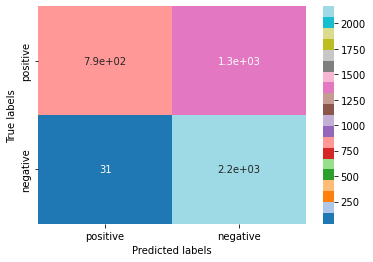

In [0]:
#Confusion Matrix
create_confusion_matrix(y, y_pred,classes)